In [1]:
from satpy import Scene, find_files_and_readers
from pyresample import create_area_def
from satpy.writers import get_enhanced_image
from datetime import datetime

import matplotlib.pyplot as plt
import numpy as np
import xarray as xr
from glob import glob

import cartopy.crs as ccrs
import cartopy.feature as cfeature
from cartopy.mpl.gridliner import LONGITUDE_FORMATTER, LATITUDE_FORMATTER

from satpy import MultiScene
from satpy.multiscene import timeseries

%matplotlib inline
import cmocean
import cmocean.cm as cmo

from dask.diagnostics import ProgressBar
from celluloid import Camera
from IPython.display import HTML

In [22]:
# Generates a list of file names
#filenames = glob('../../SAT_DATA/HDF/MODIS_AQUA_APR-2_APR-22_2022_HDF_L1\\MYD021KM*.hdf')
filenames = glob('../../SAT_DATA/HDF/MODIS_AQUA_OCT-22_NOV-14_2022_HDF_L1/MYD021KM.*.hdf')
filenames.sort()
filenames

['../../SAT_DATA/HDF/MODIS_AQUA_OCT-22_NOV-14_2022_HDF_L1\\MYD021KM.A2021295.1815.061.2021296151433.hdf',
 '../../SAT_DATA/HDF/MODIS_AQUA_OCT-22_NOV-14_2022_HDF_L1\\MYD021KM.A2021295.1955.061.2021296152519.hdf',
 '../../SAT_DATA/HDF/MODIS_AQUA_OCT-22_NOV-14_2022_HDF_L1\\MYD021KM.A2021296.1855.061.2021297151905.hdf',
 '../../SAT_DATA/HDF/MODIS_AQUA_OCT-22_NOV-14_2022_HDF_L1\\MYD021KM.A2021296.1900.061.2021297151948.hdf',
 '../../SAT_DATA/HDF/MODIS_AQUA_OCT-22_NOV-14_2022_HDF_L1\\MYD021KM.A2021297.1805.061.2021298152848.hdf',
 '../../SAT_DATA/HDF/MODIS_AQUA_OCT-22_NOV-14_2022_HDF_L1\\MYD021KM.A2021297.1940.061.2021298152913.hdf',
 '../../SAT_DATA/HDF/MODIS_AQUA_OCT-22_NOV-14_2022_HDF_L1\\MYD021KM.A2021298.1845.061.2021299151938.hdf',
 '../../SAT_DATA/HDF/MODIS_AQUA_OCT-22_NOV-14_2022_HDF_L1\\MYD021KM.A2021299.1930.061.2021300151301.hdf',
 '../../SAT_DATA/HDF/MODIS_AQUA_OCT-22_NOV-14_2022_HDF_L1\\MYD021KM.A2021300.1835.061.2021301151805.hdf',
 '../../SAT_DATA/HDF/MODIS_AQUA_OCT-22_NOV-14_

In [23]:
#swat is each file individually 
swats = np.unique([f.split('.')[5] for f in filenames])
swats

array(['A2021295', 'A2021296', 'A2021297', 'A2021298', 'A2021299',
       'A2021300', 'A2021301', 'A2021302', 'A2021303', 'A2021304',
       'A2021305', 'A2021306', 'A2021307', 'A2021308', 'A2021309',
       'A2021310', 'A2021311', 'A2021312', 'A2021313', 'A2021314',
       'A2021315', 'A2021316', 'A2021317', 'A2021318'], dtype='<U8')

In [24]:
# Define the base
#base = '../../SAT_DATA/HDF/MODIS_AQUA_APR-2_APR-22_2022_HDF_L1\\MYD021KM.'
base = '../../SAT_DATA/HDF/MODIS_AQUA_OCT-22_NOV-14_2022_HDF_L1/\\MYD021KM.'

['../../SAT_DATA/HDF/MODIS_AQUA_OCT-22_NOV-14_2022_HDF_L1\\MYD021KM.A2021295.1815.061.2021296151433.hdf', '../../SAT_DATA/HDF/MODIS_AQUA_OCT-22_NOV-14_2022_HDF_L1\\MYD021KM.A2021295.1955.061.2021296152519.hdf']


C:\Users\12532\miniconda3\envs\Bugs\lib\site-packages\satpy\modifiers\angles.py:407: RuntimeWarning: invalid value encountered in log
  grad_factor = 1. - np.log(grad_factor + 1) / np.log(2)
C:\Users\12532\miniconda3\envs\Bugs\lib\site-packages\dask\core.py:119: RuntimeWarning: invalid value encountered in arccos
  return func(*(_execute_task(a, cache) for a in args))
C:\Users\12532\miniconda3\envs\Bugs\lib\site-packages\satpy\modifiers\angles.py:407: RuntimeWarning: invalid value encountered in log
  grad_factor = 1. - np.log(grad_factor + 1) / np.log(2)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


['../../SAT_DATA/HDF/MODIS_AQUA_OCT-22_NOV-14_2022_HDF_L1\\MYD021KM.A2021296.1855.061.2021297151905.hdf', '../../SAT_DATA/HDF/MODIS_AQUA_OCT-22_NOV-14_2022_HDF_L1\\MYD021KM.A2021296.1900.061.2021297151948.hdf']


C:\Users\12532\miniconda3\envs\Bugs\lib\site-packages\satpy\modifiers\angles.py:407: RuntimeWarning: invalid value encountered in log
  grad_factor = 1. - np.log(grad_factor + 1) / np.log(2)
C:\Users\12532\miniconda3\envs\Bugs\lib\site-packages\dask\core.py:119: RuntimeWarning: invalid value encountered in arccos
  return func(*(_execute_task(a, cache) for a in args))
C:\Users\12532\miniconda3\envs\Bugs\lib\site-packages\satpy\modifiers\angles.py:407: RuntimeWarning: invalid value encountered in log
  grad_factor = 1. - np.log(grad_factor + 1) / np.log(2)
C:\Users\12532\miniconda3\envs\Bugs\lib\site-packages\dask\core.py:119: RuntimeWarning: invalid value encountered in arccos
  return func(*(_execute_task(a, cache) for a in args))
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


['../../SAT_DATA/HDF/MODIS_AQUA_OCT-22_NOV-14_2022_HDF_L1\\MYD021KM.A2021297.1805.061.2021298152848.hdf', '../../SAT_DATA/HDF/MODIS_AQUA_OCT-22_NOV-14_2022_HDF_L1\\MYD021KM.A2021297.1940.061.2021298152913.hdf']


C:\Users\12532\miniconda3\envs\Bugs\lib\site-packages\satpy\modifiers\angles.py:407: RuntimeWarning: invalid value encountered in log
  grad_factor = 1. - np.log(grad_factor + 1) / np.log(2)
C:\Users\12532\miniconda3\envs\Bugs\lib\site-packages\dask\core.py:119: RuntimeWarning: invalid value encountered in arccos
  return func(*(_execute_task(a, cache) for a in args))
C:\Users\12532\miniconda3\envs\Bugs\lib\site-packages\satpy\modifiers\angles.py:407: RuntimeWarning: invalid value encountered in log
  grad_factor = 1. - np.log(grad_factor + 1) / np.log(2)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


['../../SAT_DATA/HDF/MODIS_AQUA_OCT-22_NOV-14_2022_HDF_L1\\MYD021KM.A2021298.1845.061.2021299151938.hdf']


C:\Users\12532\miniconda3\envs\Bugs\lib\site-packages\satpy\modifiers\angles.py:407: RuntimeWarning: invalid value encountered in log
  grad_factor = 1. - np.log(grad_factor + 1) / np.log(2)
C:\Users\12532\miniconda3\envs\Bugs\lib\site-packages\dask\core.py:119: RuntimeWarning: invalid value encountered in arccos
  return func(*(_execute_task(a, cache) for a in args))
C:\Users\12532\miniconda3\envs\Bugs\lib\site-packages\dask\core.py:119: RuntimeWarning: invalid value encountered in arccos
  return func(*(_execute_task(a, cache) for a in args))
C:\Users\12532\miniconda3\envs\Bugs\lib\site-packages\satpy\modifiers\angles.py:407: RuntimeWarning: invalid value encountered in log
  grad_factor = 1. - np.log(grad_factor + 1) / np.log(2)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


['../../SAT_DATA/HDF/MODIS_AQUA_OCT-22_NOV-14_2022_HDF_L1\\MYD021KM.A2021299.1930.061.2021300151301.hdf']


C:\Users\12532\miniconda3\envs\Bugs\lib\site-packages\satpy\modifiers\angles.py:407: RuntimeWarning: invalid value encountered in log
  grad_factor = 1. - np.log(grad_factor + 1) / np.log(2)
C:\Users\12532\miniconda3\envs\Bugs\lib\site-packages\dask\core.py:119: RuntimeWarning: invalid value encountered in arccos
  return func(*(_execute_task(a, cache) for a in args))
C:\Users\12532\miniconda3\envs\Bugs\lib\site-packages\satpy\modifiers\angles.py:407: RuntimeWarning: invalid value encountered in log
  grad_factor = 1. - np.log(grad_factor + 1) / np.log(2)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


['../../SAT_DATA/HDF/MODIS_AQUA_OCT-22_NOV-14_2022_HDF_L1\\MYD021KM.A2021300.1835.061.2021301151805.hdf', '../../SAT_DATA/HDF/MODIS_AQUA_OCT-22_NOV-14_2022_HDF_L1\\MYD021KM.A2021300.2010.061.2021301152744.hdf', '../../SAT_DATA/HDF/MODIS_AQUA_OCT-22_NOV-14_2022_HDF_L1\\MYD021KM.A2021300.2015.061.2021301152822.hdf']


C:\Users\12532\miniconda3\envs\Bugs\lib\site-packages\dask\core.py:119: RuntimeWarning: invalid value encountered in arccos
  return func(*(_execute_task(a, cache) for a in args))
C:\Users\12532\miniconda3\envs\Bugs\lib\site-packages\satpy\modifiers\angles.py:407: RuntimeWarning: invalid value encountered in log
  grad_factor = 1. - np.log(grad_factor + 1) / np.log(2)
C:\Users\12532\miniconda3\envs\Bugs\lib\site-packages\satpy\modifiers\angles.py:407: RuntimeWarning: invalid value encountered in log
  grad_factor = 1. - np.log(grad_factor + 1) / np.log(2)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


['../../SAT_DATA/HDF/MODIS_AQUA_OCT-22_NOV-14_2022_HDF_L1\\MYD021KM.A2021301.1915.061.2021302173041.hdf', '../../SAT_DATA/HDF/MODIS_AQUA_OCT-22_NOV-14_2022_HDF_L1\\MYD021KM.A2021301.1920.061.2021302173055.hdf']


C:\Users\12532\miniconda3\envs\Bugs\lib\site-packages\dask\core.py:119: RuntimeWarning: invalid value encountered in arccos
  return func(*(_execute_task(a, cache) for a in args))
C:\Users\12532\miniconda3\envs\Bugs\lib\site-packages\satpy\modifiers\angles.py:407: RuntimeWarning: invalid value encountered in log
  grad_factor = 1. - np.log(grad_factor + 1) / np.log(2)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


['../../SAT_DATA/HDF/MODIS_AQUA_OCT-22_NOV-14_2022_HDF_L1\\MYD021KM.A2021302.1820.061.2021303154655.hdf', '../../SAT_DATA/HDF/MODIS_AQUA_OCT-22_NOV-14_2022_HDF_L1\\MYD021KM.A2021302.2000.061.2021303154433.hdf']


C:\Users\12532\miniconda3\envs\Bugs\lib\site-packages\dask\core.py:119: RuntimeWarning: invalid value encountered in arccos
  return func(*(_execute_task(a, cache) for a in args))
C:\Users\12532\miniconda3\envs\Bugs\lib\site-packages\satpy\modifiers\angles.py:407: RuntimeWarning: invalid value encountered in log
  grad_factor = 1. - np.log(grad_factor + 1) / np.log(2)
C:\Users\12532\miniconda3\envs\Bugs\lib\site-packages\satpy\modifiers\angles.py:407: RuntimeWarning: invalid value encountered in log
  grad_factor = 1. - np.log(grad_factor + 1) / np.log(2)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


['../../SAT_DATA/HDF/MODIS_AQUA_OCT-22_NOV-14_2022_HDF_L1\\MYD021KM.A2021303.1905.061.2021304152133.hdf']


C:\Users\12532\miniconda3\envs\Bugs\lib\site-packages\satpy\modifiers\angles.py:407: RuntimeWarning: invalid value encountered in log
  grad_factor = 1. - np.log(grad_factor + 1) / np.log(2)
C:\Users\12532\miniconda3\envs\Bugs\lib\site-packages\dask\core.py:119: RuntimeWarning: invalid value encountered in arccos
  return func(*(_execute_task(a, cache) for a in args))
C:\Users\12532\miniconda3\envs\Bugs\lib\site-packages\satpy\modifiers\angles.py:407: RuntimeWarning: invalid value encountered in log
  grad_factor = 1. - np.log(grad_factor + 1) / np.log(2)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


['../../SAT_DATA/HDF/MODIS_AQUA_OCT-22_NOV-14_2022_HDF_L1\\MYD021KM.A2021304.1810.061.2021305150643.hdf', '../../SAT_DATA/HDF/MODIS_AQUA_OCT-22_NOV-14_2022_HDF_L1\\MYD021KM.A2021304.1945.061.2021305150843.hdf', '../../SAT_DATA/HDF/MODIS_AQUA_OCT-22_NOV-14_2022_HDF_L1\\MYD021KM.A2021304.1950.061.2021305151614.hdf']


C:\Users\12532\miniconda3\envs\Bugs\lib\site-packages\satpy\modifiers\angles.py:407: RuntimeWarning: invalid value encountered in log
  grad_factor = 1. - np.log(grad_factor + 1) / np.log(2)
C:\Users\12532\miniconda3\envs\Bugs\lib\site-packages\dask\core.py:119: RuntimeWarning: invalid value encountered in arccos
  return func(*(_execute_task(a, cache) for a in args))
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


['../../SAT_DATA/HDF/MODIS_AQUA_OCT-22_NOV-14_2022_HDF_L1\\MYD021KM.A2021305.1850.061.2021306152526.hdf', '../../SAT_DATA/HDF/MODIS_AQUA_OCT-22_NOV-14_2022_HDF_L1\\MYD021KM.A2021305.1855.061.2021306152546.hdf']


C:\Users\12532\miniconda3\envs\Bugs\lib\site-packages\satpy\modifiers\angles.py:407: RuntimeWarning: invalid value encountered in log
  grad_factor = 1. - np.log(grad_factor + 1) / np.log(2)
C:\Users\12532\miniconda3\envs\Bugs\lib\site-packages\dask\core.py:119: RuntimeWarning: invalid value encountered in arccos
  return func(*(_execute_task(a, cache) for a in args))
C:\Users\12532\miniconda3\envs\Bugs\lib\site-packages\satpy\modifiers\angles.py:407: RuntimeWarning: invalid value encountered in log
  grad_factor = 1. - np.log(grad_factor + 1) / np.log(2)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


['../../SAT_DATA/HDF/MODIS_AQUA_OCT-22_NOV-14_2022_HDF_L1\\MYD021KM.A2021306.1935.061.2021307152842.hdf']


C:\Users\12532\miniconda3\envs\Bugs\lib\site-packages\satpy\modifiers\angles.py:407: RuntimeWarning: invalid value encountered in log
  grad_factor = 1. - np.log(grad_factor + 1) / np.log(2)
C:\Users\12532\miniconda3\envs\Bugs\lib\site-packages\satpy\modifiers\angles.py:407: RuntimeWarning: invalid value encountered in log
  grad_factor = 1. - np.log(grad_factor + 1) / np.log(2)
C:\Users\12532\miniconda3\envs\Bugs\lib\site-packages\dask\core.py:119: RuntimeWarning: invalid value encountered in arccos
  return func(*(_execute_task(a, cache) for a in args))
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


['../../SAT_DATA/HDF/MODIS_AQUA_OCT-22_NOV-14_2022_HDF_L1\\MYD021KM.A2021307.1840.061.2021308153223.hdf', '../../SAT_DATA/HDF/MODIS_AQUA_OCT-22_NOV-14_2022_HDF_L1\\MYD021KM.A2021307.2020.061.2021308153252.hdf']


C:\Users\12532\miniconda3\envs\Bugs\lib\site-packages\satpy\modifiers\angles.py:407: RuntimeWarning: invalid value encountered in log
  grad_factor = 1. - np.log(grad_factor + 1) / np.log(2)
C:\Users\12532\miniconda3\envs\Bugs\lib\site-packages\dask\core.py:119: RuntimeWarning: invalid value encountered in arccos
  return func(*(_execute_task(a, cache) for a in args))
C:\Users\12532\miniconda3\envs\Bugs\lib\site-packages\satpy\modifiers\angles.py:407: RuntimeWarning: invalid value encountered in log
  grad_factor = 1. - np.log(grad_factor + 1) / np.log(2)
C:\Users\12532\miniconda3\envs\Bugs\lib\site-packages\dask\core.py:119: RuntimeWarning: invalid value encountered in arccos
  return func(*(_execute_task(a, cache) for a in args))
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


['../../SAT_DATA/HDF/MODIS_AQUA_OCT-22_NOV-14_2022_HDF_L1\\MYD021KM.A2021308.1920.061.2021309154438.hdf', '../../SAT_DATA/HDF/MODIS_AQUA_OCT-22_NOV-14_2022_HDF_L1\\MYD021KM.A2021308.1925.061.2021309154000.hdf']


C:\Users\12532\miniconda3\envs\Bugs\lib\site-packages\satpy\modifiers\angles.py:407: RuntimeWarning: invalid value encountered in log
  grad_factor = 1. - np.log(grad_factor + 1) / np.log(2)
C:\Users\12532\miniconda3\envs\Bugs\lib\site-packages\dask\core.py:119: RuntimeWarning: invalid value encountered in arccos
  return func(*(_execute_task(a, cache) for a in args))
C:\Users\12532\miniconda3\envs\Bugs\lib\site-packages\satpy\modifiers\angles.py:407: RuntimeWarning: invalid value encountered in log
  grad_factor = 1. - np.log(grad_factor + 1) / np.log(2)
C:\Users\12532\miniconda3\envs\Bugs\lib\site-packages\dask\core.py:119: RuntimeWarning: invalid value encountered in arccos
  return func(*(_execute_task(a, cache) for a in args))


['../../SAT_DATA/HDF/MODIS_AQUA_OCT-22_NOV-14_2022_HDF_L1\\MYD021KM.A2021309.1825.061.2021310154058.hdf', '../../SAT_DATA/HDF/MODIS_AQUA_OCT-22_NOV-14_2022_HDF_L1\\MYD021KM.A2021309.1830.061.2021310154053.hdf', '../../SAT_DATA/HDF/MODIS_AQUA_OCT-22_NOV-14_2022_HDF_L1\\MYD021KM.A2021309.2005.061.2021310154120.hdf']


C:\Users\12532\miniconda3\envs\Bugs\lib\site-packages\satpy\modifiers\angles.py:407: RuntimeWarning: invalid value encountered in log
  grad_factor = 1. - np.log(grad_factor + 1) / np.log(2)
C:\Users\12532\miniconda3\envs\Bugs\lib\site-packages\dask\core.py:119: RuntimeWarning: invalid value encountered in arccos
  return func(*(_execute_task(a, cache) for a in args))
C:\Users\12532\miniconda3\envs\Bugs\lib\site-packages\satpy\modifiers\angles.py:407: RuntimeWarning: invalid value encountered in log
  grad_factor = 1. - np.log(grad_factor + 1) / np.log(2)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


['../../SAT_DATA/HDF/MODIS_AQUA_OCT-22_NOV-14_2022_HDF_L1\\MYD021KM.A2021310.1910.061.2021311155318.hdf']


C:\Users\12532\miniconda3\envs\Bugs\lib\site-packages\satpy\modifiers\angles.py:407: RuntimeWarning: invalid value encountered in log
  grad_factor = 1. - np.log(grad_factor + 1) / np.log(2)
C:\Users\12532\miniconda3\envs\Bugs\lib\site-packages\dask\core.py:119: RuntimeWarning: invalid value encountered in arccos
  return func(*(_execute_task(a, cache) for a in args))
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


['../../SAT_DATA/HDF/MODIS_AQUA_OCT-22_NOV-14_2022_HDF_L1\\MYD021KM.A2021311.1815.061.2021312154141.hdf', '../../SAT_DATA/HDF/MODIS_AQUA_OCT-22_NOV-14_2022_HDF_L1\\MYD021KM.A2021311.1955.061.2021312154258.hdf']


C:\Users\12532\miniconda3\envs\Bugs\lib\site-packages\satpy\modifiers\angles.py:407: RuntimeWarning: invalid value encountered in log
  grad_factor = 1. - np.log(grad_factor + 1) / np.log(2)
C:\Users\12532\miniconda3\envs\Bugs\lib\site-packages\dask\core.py:119: RuntimeWarning: invalid value encountered in arccos
  return func(*(_execute_task(a, cache) for a in args))
C:\Users\12532\miniconda3\envs\Bugs\lib\site-packages\satpy\modifiers\angles.py:407: RuntimeWarning: invalid value encountered in log
  grad_factor = 1. - np.log(grad_factor + 1) / np.log(2)
C:\Users\12532\miniconda3\envs\Bugs\lib\site-packages\dask\core.py:119: RuntimeWarning: invalid value encountered in arccos
  return func(*(_execute_task(a, cache) for a in args))
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


['../../SAT_DATA/HDF/MODIS_AQUA_OCT-22_NOV-14_2022_HDF_L1\\MYD021KM.A2021312.1855.061.2021313154516.hdf', '../../SAT_DATA/HDF/MODIS_AQUA_OCT-22_NOV-14_2022_HDF_L1\\MYD021KM.A2021312.1900.061.2021313154455.hdf']


C:\Users\12532\miniconda3\envs\Bugs\lib\site-packages\satpy\modifiers\angles.py:407: RuntimeWarning: invalid value encountered in log
  grad_factor = 1. - np.log(grad_factor + 1) / np.log(2)
C:\Users\12532\miniconda3\envs\Bugs\lib\site-packages\dask\core.py:119: RuntimeWarning: invalid value encountered in arccos
  return func(*(_execute_task(a, cache) for a in args))
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


['../../SAT_DATA/HDF/MODIS_AQUA_OCT-22_NOV-14_2022_HDF_L1\\MYD021KM.A2021313.1805.061.2021315024721.hdf', '../../SAT_DATA/HDF/MODIS_AQUA_OCT-22_NOV-14_2022_HDF_L1\\MYD021KM.A2021313.1940.061.2021315024114.hdf', '../../SAT_DATA/HDF/MODIS_AQUA_OCT-22_NOV-14_2022_HDF_L1\\MYD021KM.A2021313.1945.061.2021315024103.hdf']


C:\Users\12532\miniconda3\envs\Bugs\lib\site-packages\satpy\modifiers\angles.py:407: RuntimeWarning: invalid value encountered in log
  grad_factor = 1. - np.log(grad_factor + 1) / np.log(2)
C:\Users\12532\miniconda3\envs\Bugs\lib\site-packages\dask\core.py:119: RuntimeWarning: invalid value encountered in arccos
  return func(*(_execute_task(a, cache) for a in args))
C:\Users\12532\miniconda3\envs\Bugs\lib\site-packages\satpy\modifiers\angles.py:407: RuntimeWarning: invalid value encountered in log
  grad_factor = 1. - np.log(grad_factor + 1) / np.log(2)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


['../../SAT_DATA/HDF/MODIS_AQUA_OCT-22_NOV-14_2022_HDF_L1\\MYD021KM.A2021314.1845.061.2021315152657.hdf']


C:\Users\12532\miniconda3\envs\Bugs\lib\site-packages\satpy\modifiers\angles.py:407: RuntimeWarning: invalid value encountered in log
  grad_factor = 1. - np.log(grad_factor + 1) / np.log(2)
C:\Users\12532\miniconda3\envs\Bugs\lib\site-packages\dask\core.py:119: RuntimeWarning: invalid value encountered in arccos
  return func(*(_execute_task(a, cache) for a in args))
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


['../../SAT_DATA/HDF/MODIS_AQUA_OCT-22_NOV-14_2022_HDF_L1\\MYD021KM.A2021315.1930.061.2021316184746.hdf']


C:\Users\12532\AppData\Local\Temp\ipykernel_22808\1841901408.py:21: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig =  plt.figure(figsize=(6, 4), dpi=400)
C:\Users\12532\miniconda3\envs\Bugs\lib\site-packages\satpy\modifiers\angles.py:407: RuntimeWarning: invalid value encountered in log
  grad_factor = 1. - np.log(grad_factor + 1) / np.log(2)
C:\Users\12532\miniconda3\envs\Bugs\lib\site-packages\dask\core.py:119: RuntimeWarning: invalid value encountered in arccos
  return func(*(_execute_task(a, cache) for a in args))
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


['../../SAT_DATA/HDF/MODIS_AQUA_OCT-22_NOV-14_2022_HDF_L1\\MYD021KM.A2021316.1835.061.2021317154148.hdf', '../../SAT_DATA/HDF/MODIS_AQUA_OCT-22_NOV-14_2022_HDF_L1\\MYD021KM.A2021316.2010.061.2021317154246.hdf', '../../SAT_DATA/HDF/MODIS_AQUA_OCT-22_NOV-14_2022_HDF_L1\\MYD021KM.A2021316.2015.061.2021317155504.hdf']


C:\Users\12532\miniconda3\envs\Bugs\lib\site-packages\satpy\modifiers\angles.py:407: RuntimeWarning: invalid value encountered in log
  grad_factor = 1. - np.log(grad_factor + 1) / np.log(2)
C:\Users\12532\miniconda3\envs\Bugs\lib\site-packages\dask\core.py:119: RuntimeWarning: invalid value encountered in arccos
  return func(*(_execute_task(a, cache) for a in args))
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


['../../SAT_DATA/HDF/MODIS_AQUA_OCT-22_NOV-14_2022_HDF_L1\\MYD021KM.A2021317.1915.061.2021318153446.hdf', '../../SAT_DATA/HDF/MODIS_AQUA_OCT-22_NOV-14_2022_HDF_L1\\MYD021KM.A2021317.1920.061.2021318153453.hdf']


C:\Users\12532\miniconda3\envs\Bugs\lib\site-packages\satpy\modifiers\angles.py:407: RuntimeWarning: invalid value encountered in log
  grad_factor = 1. - np.log(grad_factor + 1) / np.log(2)
C:\Users\12532\miniconda3\envs\Bugs\lib\site-packages\dask\core.py:119: RuntimeWarning: invalid value encountered in arccos
  return func(*(_execute_task(a, cache) for a in args))
C:\Users\12532\miniconda3\envs\Bugs\lib\site-packages\satpy\modifiers\angles.py:407: RuntimeWarning: invalid value encountered in log
  grad_factor = 1. - np.log(grad_factor + 1) / np.log(2)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


['../../SAT_DATA/HDF/MODIS_AQUA_OCT-22_NOV-14_2022_HDF_L1\\MYD021KM.A2021318.1820.061.2021320193748.hdf', '../../SAT_DATA/HDF/MODIS_AQUA_OCT-22_NOV-14_2022_HDF_L1\\MYD021KM.A2021318.2000.061.2021320193817.hdf']


C:\Users\12532\miniconda3\envs\Bugs\lib\site-packages\satpy\modifiers\angles.py:407: RuntimeWarning: invalid value encountered in log
  grad_factor = 1. - np.log(grad_factor + 1) / np.log(2)
C:\Users\12532\miniconda3\envs\Bugs\lib\site-packages\dask\core.py:119: RuntimeWarning: invalid value encountered in arccos
  return func(*(_execute_task(a, cache) for a in args))
C:\Users\12532\miniconda3\envs\Bugs\lib\site-packages\satpy\modifiers\angles.py:407: RuntimeWarning: invalid value encountered in log
  grad_factor = 1. - np.log(grad_factor + 1) / np.log(2)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


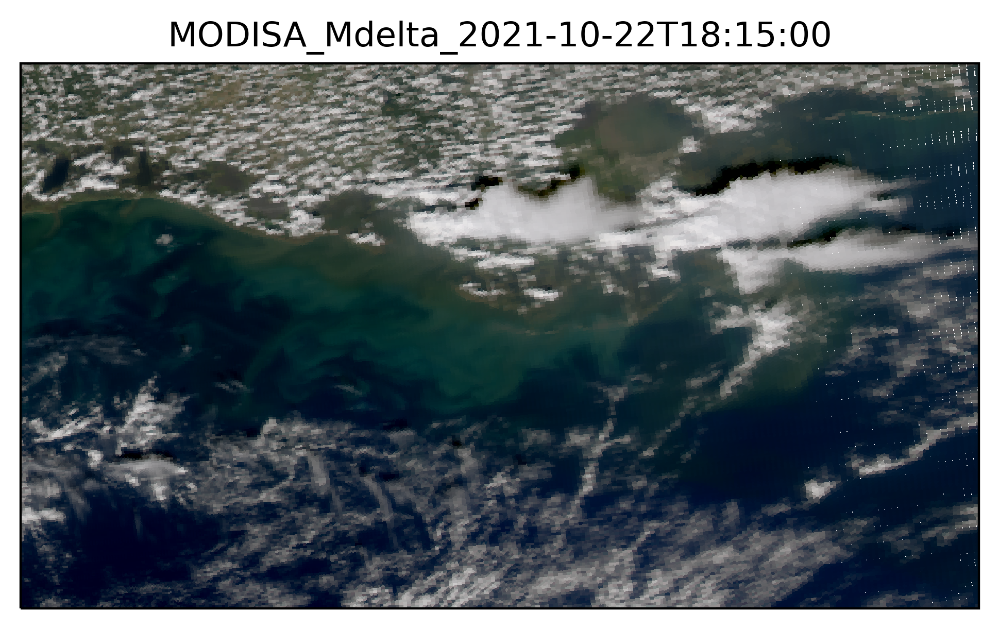

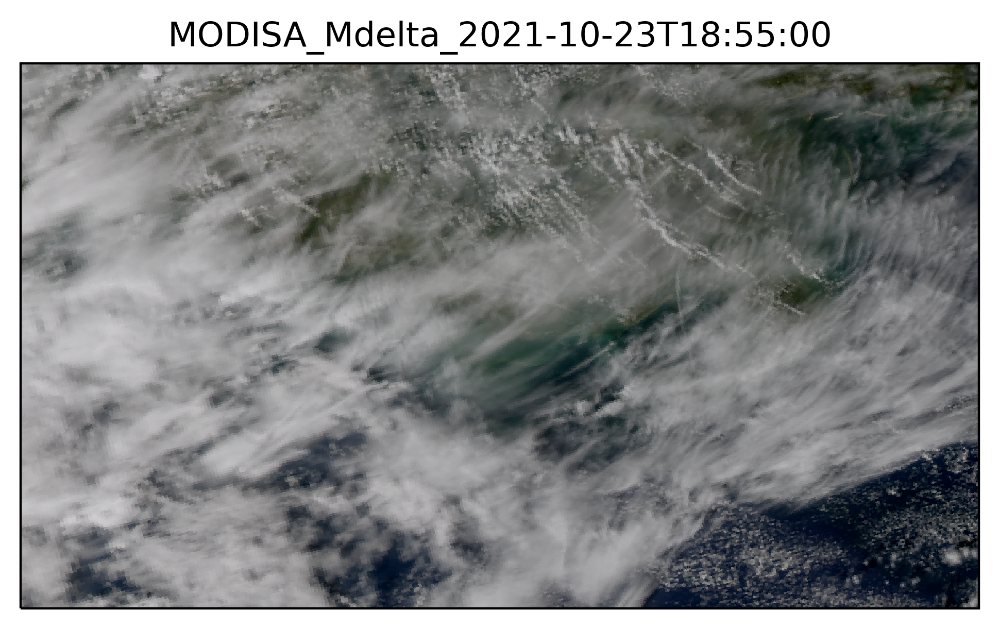

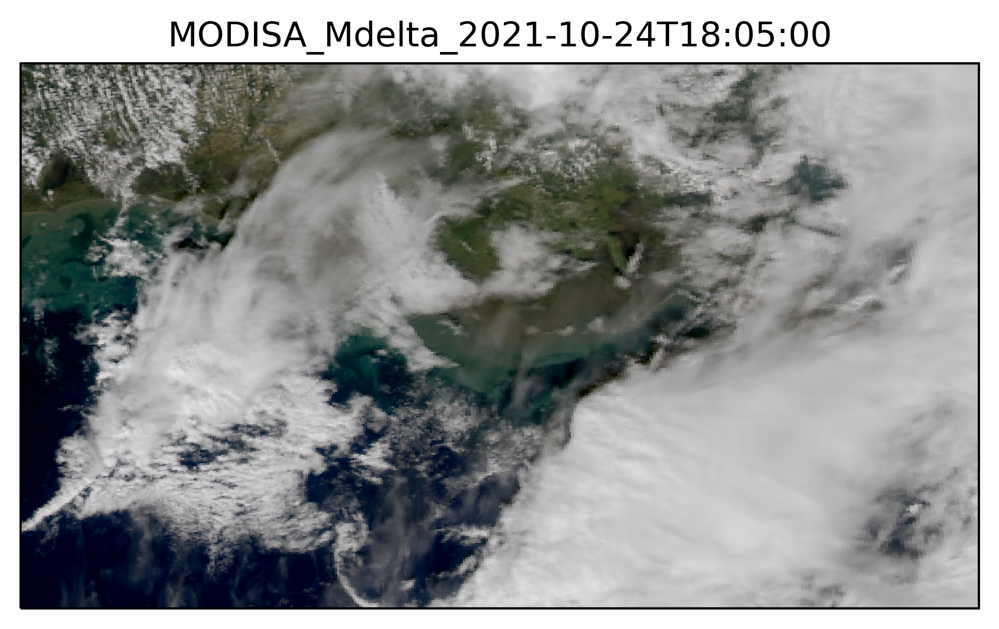

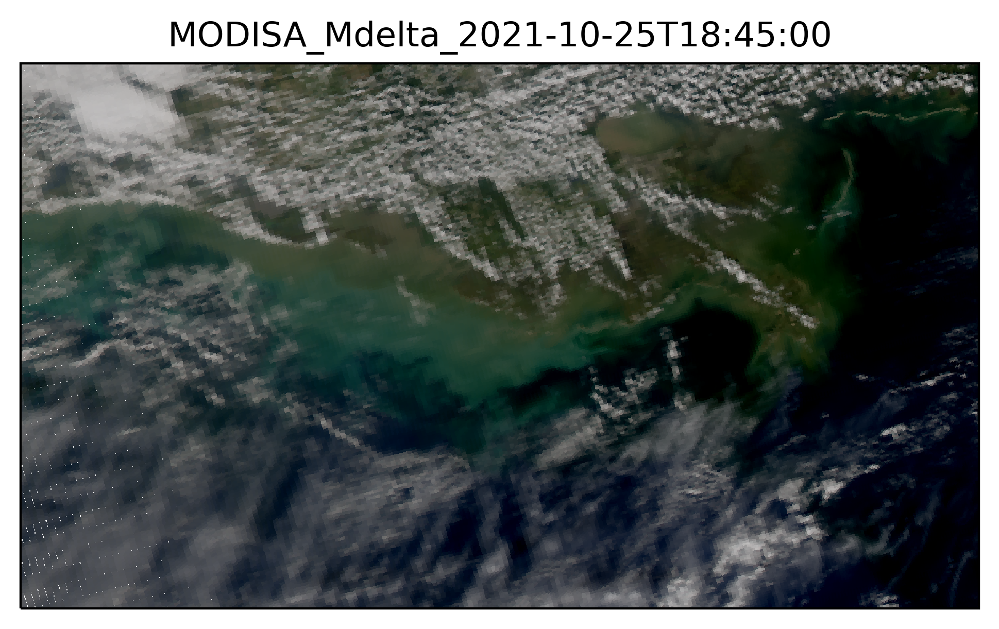

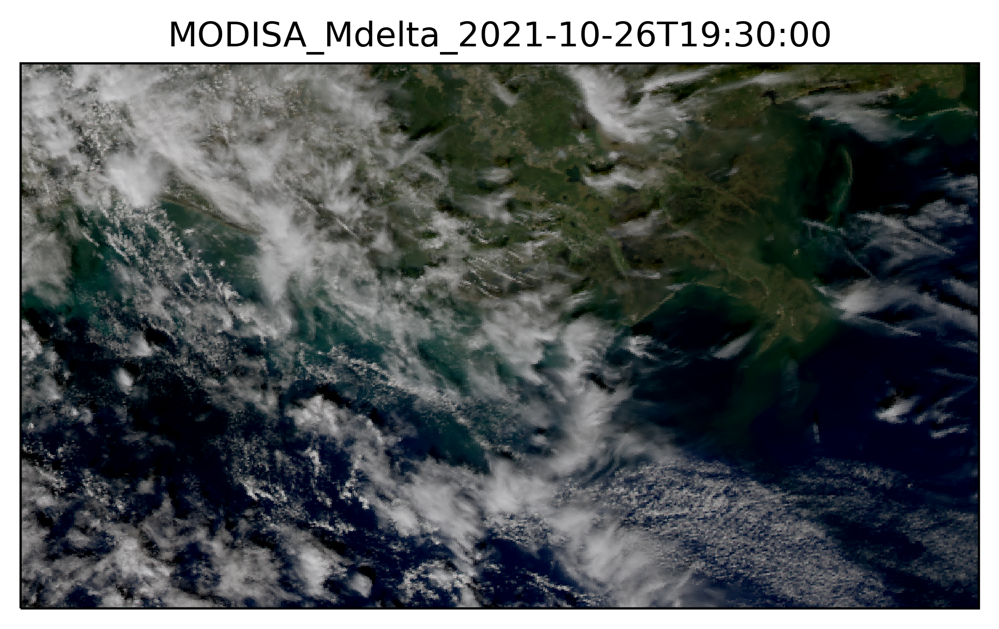

...

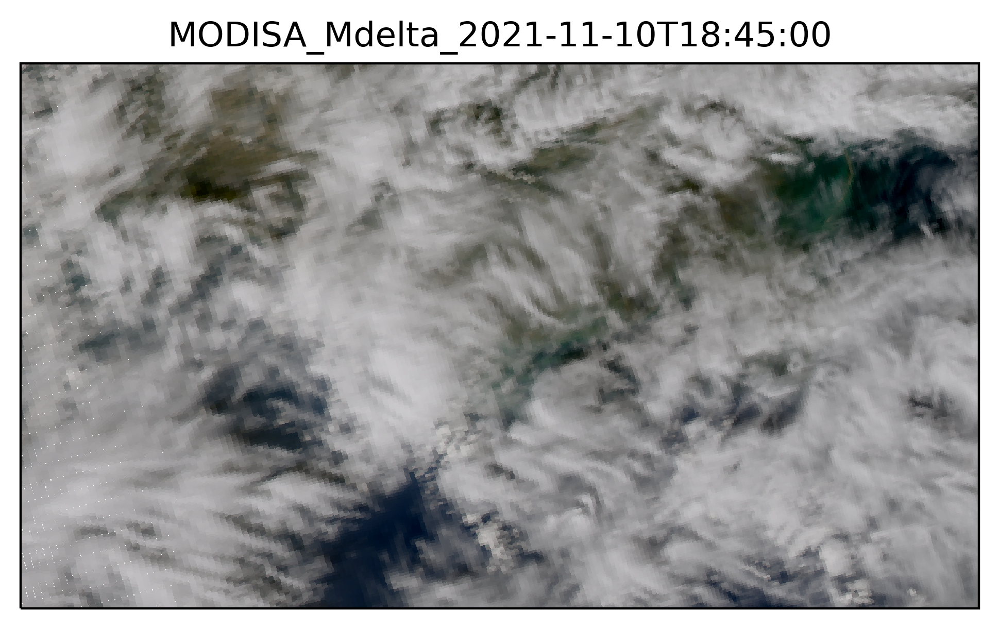

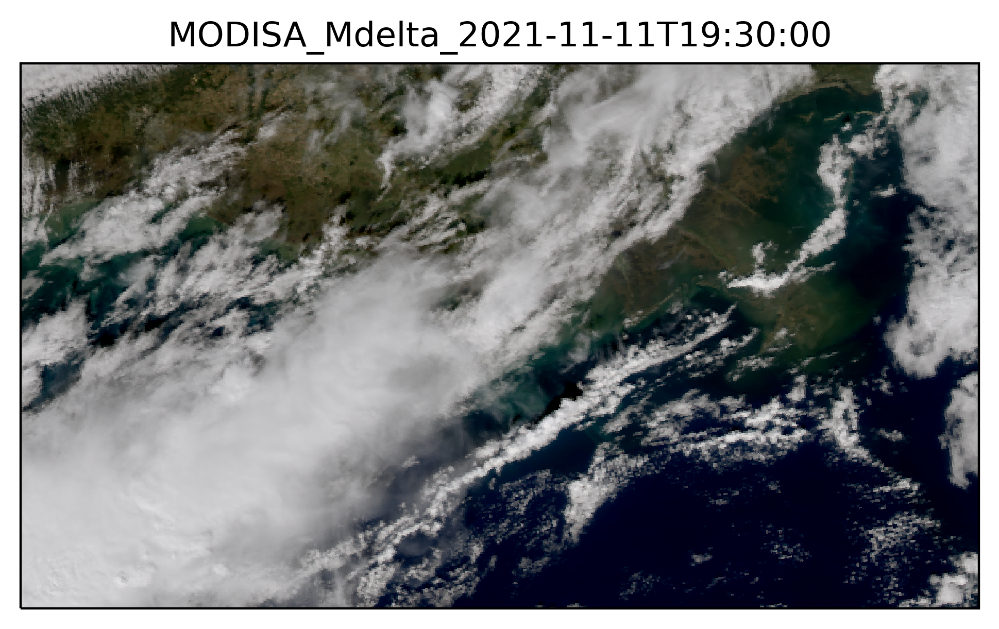

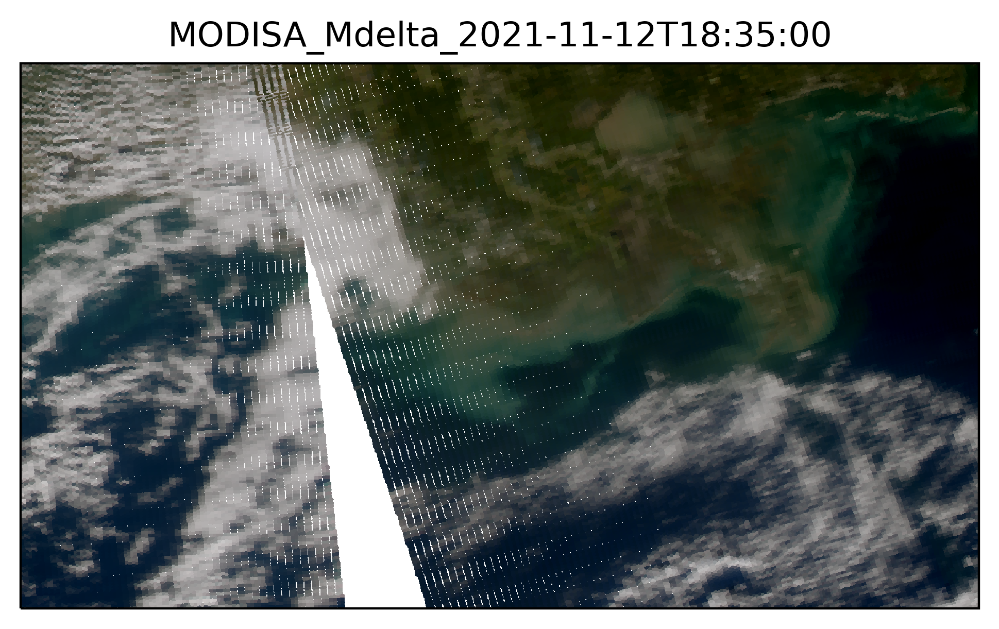

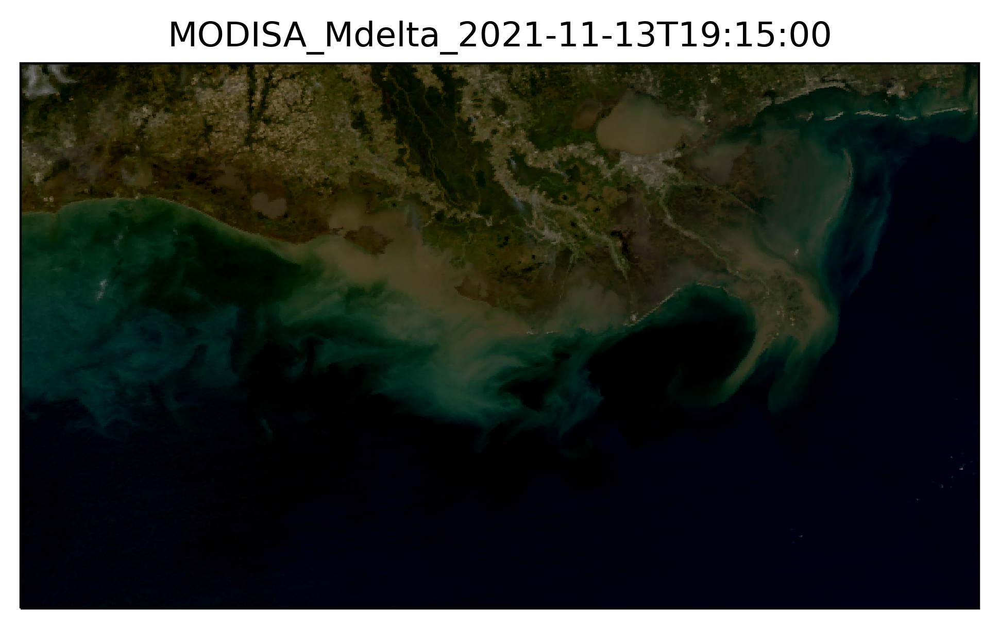

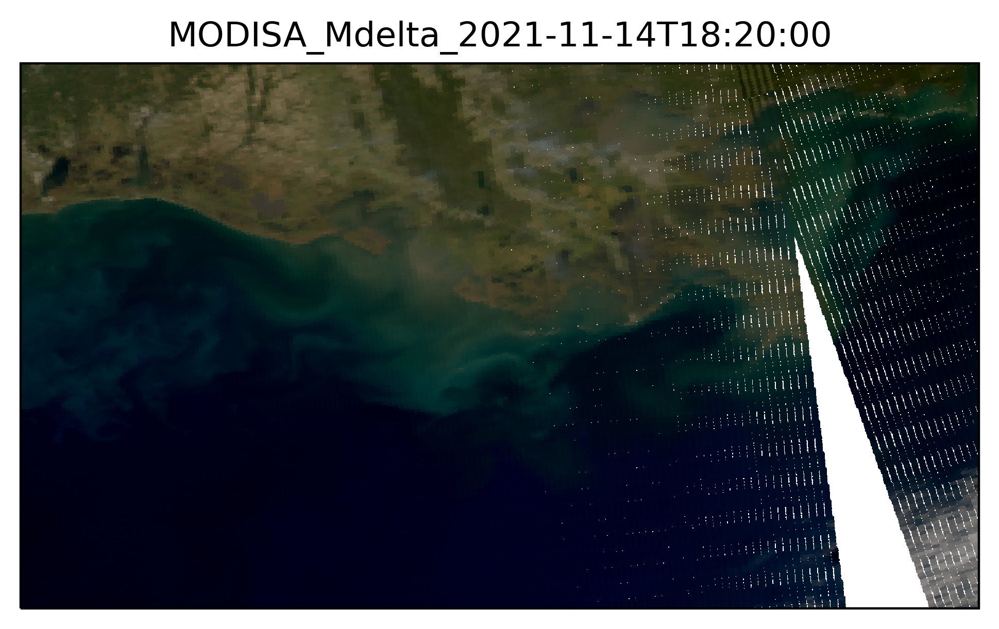

In [25]:
#lets do the loop this lets us pick our best one 
for swat in swats:
    dayfiles = glob(base+swat+'*')

    print(dayfiles)
    #create scene
    scn = Scene(dayfiles, reader='modis_l1b')
    scn.load(['10','4'])
    scn.load(['true_color'])
    #reprpject
    my_area = create_area_def('my_area', {'proj': 'lcc', 'lon_0': -91., 'lat_0': 29.5, 'lat_1': 29.5, 'lat_2': 29.5},
                              width=1500, height=750,
                              area_extent=[-94, 27.5, -88, 30.5], units='degrees')
    new_scn = scn.resample(my_area)
    #generate RGB from true color
    rgb = get_enhanced_image(new_scn['true_color'])

    #extract projection and lon lat from products
    crs = new_scn['true_color'].attrs['area'].to_cartopy_crs()

    fig =  plt.figure(figsize=(6, 4), dpi=400)
    ax1 = plt.subplot(projection=crs)
    rgb.data.plot.imshow(rgb='bands', transform=crs, ax=ax1)
    ax1.set_title('MODISA_Mdelta_%s' % new_scn.start_time.isoformat())
    #fig.savefig('MODISA_Mdelta_%s_rgb.png' % new_scn.start_time.isoformat())

['../../SAT_DATA/HDF/MODIS_AQUA_OCT-22_NOV-14_2022_HDF_L1\\MYD021KM.A2021317.1915.061.2021318153446.hdf', '../../SAT_DATA/HDF/MODIS_AQUA_OCT-22_NOV-14_2022_HDF_L1\\MYD021KM.A2021317.1920.061.2021318153453.hdf']


C:\Users\12532\miniconda3\envs\Bugs\lib\site-packages\satpy\modifiers\angles.py:407: RuntimeWarning: invalid value encountered in log
  grad_factor = 1. - np.log(grad_factor + 1) / np.log(2)
C:\Users\12532\miniconda3\envs\Bugs\lib\site-packages\dask\core.py:119: RuntimeWarning: invalid value encountered in arccos
  return func(*(_execute_task(a, cache) for a in args))
C:\Users\12532\miniconda3\envs\Bugs\lib\site-packages\satpy\modifiers\angles.py:407: RuntimeWarning: invalid value encountered in log
  grad_factor = 1. - np.log(grad_factor + 1) / np.log(2)
C:\Users\12532\miniconda3\envs\Bugs\lib\site-packages\dask\core.py:119: RuntimeWarning: invalid value encountered in arccos
  return func(*(_execute_task(a, cache) for a in args))
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


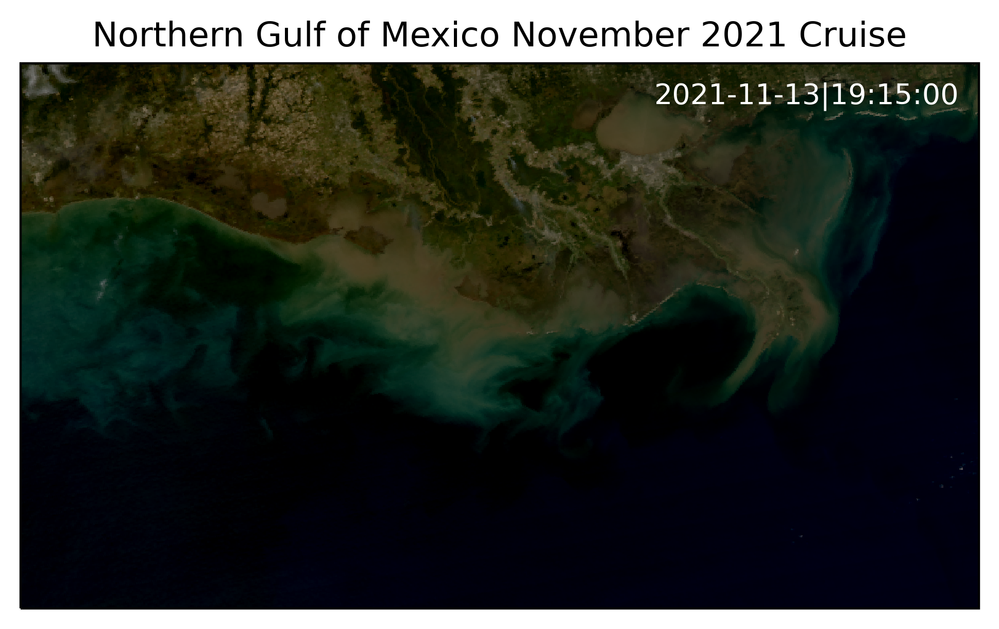

In [31]:
# now make just one image that is pretty 
i=0
#dayfiles = glob(base+swats[5]+'*') #for april 2022
dayfiles = glob(base+swats[22]+'*') #for oct nov 2021
print(dayfiles)
#create scene
scn = Scene(dayfiles, reader='modis_l1b')
scn.load(['10','4'])
scn.load(['true_color'])
#reprpject
my_area = create_area_def('my_area', {'proj': 'lcc', 'lon_0': -91., 'lat_0': 29.5, 'lat_1': 29.5, 'lat_2': 29.5},
                          width=1500, height=750,
                          area_extent=[-94, 27.5, -88, 30.5], units='degrees')
new_scn = scn.resample(my_area)
#generate RGB from true color
rgb = get_enhanced_image(new_scn['true_color'])

#extract projection and lon lat from products
crs = new_scn['true_color'].attrs['area'].to_cartopy_crs()

fig =  plt.figure(figsize=(6, 4), dpi=400)
ax1 = plt.subplot(projection=crs)
rgb.data.plot.imshow(rgb='bands', transform=crs, ax=ax1)
#ax1.set_title('Northern Gulf of Mexico April 2022 Cruise')
ax1.set_title('Northern Gulf of Mexico November 2021 Cruise')
ax1.annotate(new_scn.start_time.isoformat("|"), (90000,90000), color='white', fontsize=10) #Top Right
#fig.savefig('../outputs/True_color_NGOM_April_2022.png')
#fig.savefig('../outputs/True_color_NGOM_November_2021.png')